In [1]:
import pandas as pd
import matplotlib as mpl
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import lightgbm as lgb

# настройка размера шрифта легенды
mpl.rcParams['legend.title_fontsize'] = 13
mpl.rcParams['legend.fontsize'] = 13

#### Изначальное чтение данных

In [2]:
data = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")

In [3]:
data.sort_values('create_time', inplace=True)
test.sort_values('create_time', inplace=True)

In [4]:
test['create_time'] = pd.to_datetime(test.create_time)
test['model_create_time'] = pd.to_datetime(test.model_create_time)
data['create_time'] = pd.to_datetime(data.create_time)
data['model_create_time'] = pd.to_datetime(data.model_create_time)

In [5]:
data['create_time'] = pd.to_datetime(data.create_time)
data['model_create_time'] = pd.to_datetime(data.model_create_time)

In [6]:
data['model_waiting_time'] =(data['create_time'] - data['model_create_time']).dt.total_seconds()
test['model_waiting_time'] = (test['create_time'] - test['model_create_time']).dt.total_seconds()

In [7]:
webstat = pd.read_csv("t1_webstat.csv")

In [8]:
pd.options.display.max_rows = 100
webstat['pageview_duration_sec'] = np.abs(webstat['pageview_duration_sec'])
webstat[webstat.sessionkey_id == 112857133]

,sessionkey_id,date_time,page_type,pageview_number,pageview_duration_sec,category_id,model_id,good_id,price,product_in_sale
2339245,112857133,1975-11-01 10:06:26.513,2,3,11.0,1870.0,NaN,NaN,NaN,NaN
2343135,112857133,1975-11-01 10:06:03.183,2,2,23.0,1870.0,NaN,NaN,NaN,NaN
2344410,112857133,1975-11-01 10:05:27.273,8,1,36.0,NaN,NaN,NaN,NaN,NaN
2344411,112857133,1975-11-01 10:10:18.723,1,6,NaN,1870.0,26627857.0,60519396.0,315.0,1.0
2350040,112857133,1975-11-01 10:06:37.373,1,4,201.0,1870.0,1458318.0,59075523.0,286.0,1.0
2350041,112857133,1975-11-01 10:09:58.907,3,5,20.0,NaN,NaN,NaN,NaN,NaN


In [9]:
data[data.is_callcenter == 1].head(10)

,order_id,create_time,good_id,price,utm_medium,utm_source,sessionkey_id,category_id,parent_id,root_id,model_id,is_moderated,rating_value,rating_count,description_length,goods_qty,pics_qty,model_create_time,is_callcenter,model_waiting_time
53649,1158435,1975-11-01 10:10:50,34953396,3891,5,8.0,112855437,137,133,124,10492835,1,NaN,NaN,0,4,1,1974-04-16 19:09:20,1,48697290.0
75351,1158438,1975-11-01 10:12:49,62965708,1822,5,13.0,112857090,155,154,153,19040816,1,NaN,NaN,0,14,2,1975-02-24 11:16:29,1,21596180.0
28077,1158439,1975-11-01 10:13:24,24296520,234,1,1.0,112857100,4268,4267,255,2121088,1,NaN,0.0,54,2,1,1972-12-01 13:15:46,1,92005058.0
26729,1158440,1975-11-01 10:13:26,20985988,761,1,1.0,112855266,134,125,124,2020995,1,5.0,3.0,0,21,4,1972-11-17 06:22:09,1,93239477.0
29447,1158444,1975-11-01 10:15:55,20932136,506,1,14.0,112856818,138,133,124,2256391,1,NaN,NaN,3015,8,2,1973-01-04 18:07:36,1,89050099.0
87188,1158445,1975-11-01 10:16:32,60519396,315,6,4.0,112857133,1870,1866,2303,26627857,0,NaN,NaN,1530,1,1,1975-07-17 13:48:21,1,9232091.0
25024,1158453,1975-11-01 10:23:16,61924857,1424,5,25.0,112857866,155,154,153,1877203,1,5.0,1.0,0,10,8,1972-10-18 16:30:18,1,95795578.0
80727,1158455,1975-11-01 10:23:20,58661394,1685,7,11.0,112814835,257,256,255,23630946,1,NaN,0.0,979,1,1,1975-05-05 12:40:04,1,15543796.0
12558,1158456,1975-11-01 10:23:48,8581909,630,1,1.0,112850173,3373,133,124,465004,1,5.0,5.0,578,28,2,1972-03-30 17:27:54,1,113244954.0
91932,1158460,1975-11-01 10:27:32,62776891,783,2,NaN,112858799,4993,1582,1493,28885419,1,4.0,1.0,40,1,3,1975-09-09 12:32:32,1,4571700.0


In [10]:
webstat.sort_values('date_time', inplace=True)

#### Аггрегируем данные из веба

In [11]:
from scipy import stats

webstat.date_time = pd.to_datetime(webstat.date_time)
session_agg = webstat.groupby('sessionkey_id', sort=False).agg(
    total_sec_dt=('date_time', lambda x: (x.iloc[-1] - x.iloc[0])),
    start_sec_dt=('date_time', lambda x: x.iloc[-1]),



    total_sec_dur=('pageview_duration_sec', lambda x: np.nansum(x)),
    ends_nan=('pageview_duration_sec', lambda x: int(pd.isna(x.iloc[-1]))),
    pageview_duration_sec_mach = ('pageview_duration_sec', lambda x: np.nanmax(x) - np.nanmin(x)),
    total_nan = ('pageview_duration_sec', lambda x: np.count_nonzero(np.isnan(x))),
    
    pageview_duration_sec_max =('pageview_duration_sec', lambda x: np.nanmax(x)),
    pageview_duration_sec_mean =('pageview_duration_sec', lambda x: np.nanmean(x)),
    pageview_duration_sec_median =('pageview_duration_sec', lambda x: np.nanmedian(x)),

    price_mean=('price', lambda x: x.mean()),
    price_max=('price', lambda x: x.max()),
    price_mach = ('price', lambda x: np.nanmax(x) - np.nanmin(x)),

    number_of_misses = ('pageview_number', lambda x: x.iloc[-1] - len(x)),


    last_page_type=('page_type', lambda x: x.iloc[-1]),
    session_size=('page_type', lambda x: x.shape[0]),
    page_type_max = ('page_type', lambda x:  max(x)),
    first_page_type = ('page_type', lambda x:  x.iloc[0]),
    first_type_max = ('page_type', lambda x:  min(x)),
    average_page_type = ('page_type', lambda x:  np.nanmean(x)),



    number_of_unique_goods = ('good_id', lambda x: len(np.unique(x))),

    proportion_of_ones = ('page_type',lambda x: len(x[x == 1]) / x.shape[0]),
    proportion_of_twos = ('page_type',lambda x: len(x[x != 1]) / x.shape[0]),



    model_id_nan = ('model_id', lambda x: np.nansum(x)),


    count_category_id = ('category_id', lambda x: len(np.unique(x))),

)
session_agg['total_sec_dt'] = session_agg['total_sec_dt'].dt.total_seconds()
session_agg['sec_diff'] = session_agg['total_sec_dt'] - session_agg['total_sec_dur']
session_agg['average_sec_miss'] = session_agg['sec_diff'] / (session_agg['number_of_misses'] + session_agg['total_nan'])
session_agg['summ_ones'] = webstat[webstat.page_type == 1].groupby('sessionkey_id', sort=False).agg(
    total_sec_dur=('pageview_duration_sec', lambda x: np.nansum(x)),
)

session_agg['page_type_mode'] = webstat.groupby('sessionkey_id', sort=False).agg(page_type_mode = ('page_type', lambda x: x.value_counts().iloc[0]),)
session_agg.reset_index(inplace=True)
session_agg.head()

/var/folders/x6/b_ylqyd127s0ckfw_r19b2880000gn/T/ipykernel_70180/3976787252.py:12: RuntimeWarning: All-NaN axis encountered
  pageview_duration_sec_mach = ('pageview_duration_sec', lambda x: np.nanmax(x) - np.nanmin(x)),
/var/folders/x6/b_ylqyd127s0ckfw_r19b2880000gn/T/ipykernel_70180/3976787252.py:15: RuntimeWarning: All-NaN axis encountered
  pageview_duration_sec_max =('pageview_duration_sec', lambda x: np.nanmax(x)),
/var/folders/x6/b_ylqyd127s0ckfw_r19b2880000gn/T/ipykernel_70180/3976787252.py:16: RuntimeWarning: Mean of empty slice
  pageview_duration_sec_mean =('pageview_duration_sec', lambda x: np.nanmean(x)),
/var/folders/x6/b_ylqyd127s0ckfw_r19b2880000gn/T/ipykernel_70180/3976787252.py:17: RuntimeWarning: All-NaN slice encountered
  pageview_duration_sec_median =('pageview_duration_sec', lambda x: np.nanmedian(x)),
/var/folders/x6/b_ylqyd127s0ckfw_r19b2880000gn/T/ipykernel_70180/3976787252.py:21: RuntimeWarning: All-NaN axis encountered
  price_mach = ('price', lambda x: np.n

,sessionkey_id,total_sec_dt,start_sec_dt,total_sec_dur,ends_nan,pageview_duration_sec_mach,total_nan,pageview_duration_sec_max,pageview_duration_sec_mean,pageview_duration_sec_median,...,average_page_type,number_of_unique_goods,proportion_of_ones,proportion_of_twos,model_id_nan,count_category_id,sec_diff,average_sec_miss,summ_ones,page_type_mode
0,109996122,89.68,1975-10-17 13:44:26.633,90.0,1,16.0,1,25.0,15.0,11.5,...,2.000000,1,0.000000,1.000000,0.0,6,-0.32,-0.320,NaN,7
1,110019268,165.56,1975-10-17 15:28:41.860,165.0,1,79.0,1,122.0,82.5,82.5,...,5.000000,2,0.333333,0.666667,8748965.0,2,0.56,0.560,43.0,2
2,110020180,0.00,1975-10-17 15:29:52.147,0.0,1,NaN,1,NaN,NaN,NaN,...,1.000000,1,1.000000,0.000000,1513237.0,1,0.00,0.000,0.0,1
3,110040418,591.49,1975-10-17 17:15:33.020,545.0,1,265.0,1,281.0,54.5,27.0,...,2.363636,3,0.363636,0.636364,31900866.0,2,46.49,23.245,404.0,5
4,110044482,0.00,1975-10-17 17:27:55.297,0.0,1,NaN,1,NaN,NaN,NaN,...,1.000000,1,1.000000,0.000000,1513237.0,1,0.00,0.000,0.0,1


#### Создаем фичи дл трейна и теста

In [12]:
X_tr = data.merge(session_agg, how='left', on='sessionkey_id', sort=False)
X_tst = test.merge(session_agg, how='left', on='sessionkey_id', sort=False)

In [13]:
session_agg_sessionkey_id_tr = X_tr.groupby('sessionkey_id', sort=False).agg(same_user_count = ('sessionkey_id', lambda x: x.size))
session_agg_sessionkey_id_tst = X_tst.groupby('sessionkey_id', sort=False).agg(same_user_count = ('sessionkey_id', lambda x: x.size))

In [14]:
session_agg_sessionkey_tr_good_id = webstat.groupby(['sessionkey_id', 'good_id'], sort=False).agg(good_duration = ('pageview_duration_sec', lambda x: np.nansum(x)))
session_agg_sessionkey_tst_good_id = webstat.groupby(['sessionkey_id', 'good_id'], sort=False).agg(good_duration = ('pageview_duration_sec', lambda x: np.nansum(x)))

In [15]:
session_agg_sessionkey_tr_cat_id = webstat.groupby(['sessionkey_id', 'category_id'], sort=False).agg(category_duration = ('pageview_duration_sec', lambda x: np.nansum(x)))
session_agg_sessionkey_tst_cat_id = webstat.groupby(['sessionkey_id', 'category_id'], sort=False).agg(category_duration = ('pageview_duration_sec', lambda x: np.nansum(x)))

In [16]:
X_tr = X_tr.merge(session_agg_sessionkey_id_tr, how='left', on='sessionkey_id', sort=False)
X_tst = X_tst.merge(session_agg_sessionkey_id_tr, how='left', on='sessionkey_id', sort=False)

In [17]:
X_tr = X_tr.merge(session_agg_sessionkey_tr_good_id, how='left', on=['sessionkey_id', 'good_id'], sort=False)
X_tst = X_tst.merge(session_agg_sessionkey_tst_good_id, how='left', on=['sessionkey_id', 'good_id'], sort=False)

In [18]:
X_tr = X_tr.merge(session_agg_sessionkey_tr_cat_id, how='left', on=['sessionkey_id', 'category_id'], sort=False)
X_tst = X_tst.merge(session_agg_sessionkey_tst_cat_id, how='left', on=['sessionkey_id', 'category_id'], sort=False)

In [19]:
X_tr['good_view_ratio'] = X_tr['good_duration'] / X_tr['total_sec_dt']
X_tst['good_view_ratio'] = X_tst['good_duration'] / X_tst['total_sec_dt']

In [20]:
X_tr['start'] = pd.to_datetime(X_tr['create_time']).dt.hour
X_tst['start'] = pd.to_datetime(X_tst['create_time']).dt.hour

In [81]:
X_tr['model_start'] = pd.to_datetime(X_tr['model_create_time']).dt.hour
X_tst['model_start'] = pd.to_datetime(X_tst['model_create_time']).dt.hour

In [21]:
X_tr['time_between_starts'] = (X_tr['create_time'] - X_tr['start_sec_dt']).dt.total_seconds()
X_tst['time_between_starts'] = (X_tst['create_time'] - X_tst['start_sec_dt']).dt.total_seconds()

In [22]:
X_tr['has_session'] = pd.isna(X_tr['start_sec_dt']).astype(int)
X_tst['has_session'] = pd.isna(X_tr['start_sec_dt']).astype(int)

In [23]:
X_tr['viewed_goods_ratio'] = X_tr.number_of_unique_goods / X_tr.goods_qty
X_tst['viewed_goods_ratio'] = X_tst.number_of_unique_goods / X_tst.goods_qty


In [24]:
X_tr['good_in_category'] = X_tr['good_duration'] / X_tr['category_duration']
X_tst['good_in_category'] = X_tst['good_duration'] / X_tst['category_duration']

In [25]:
X_tr['money_spent'] = X_tr.price * X_tr.goods_qty
X_tst['money_spent'] = X_tst.price * X_tst.goods_qty

In [294]:
X_tr['shap'] = np.concatenate((train_clusters_shap, val_clusters_shap))
X_tst['shap'] = tst_clusters_shap

In [74]:
X_tr['leaves'] = np.concatenate((tr_clusters_leaves, val_clusters_leaves[0]))
X_tst['leaves'] = tst_clusters_leaves[0]

In [64]:
X_tr['knn'] = np.concatenate((predictions_train, predictions_val))
X_tst['knn'] = predictions_tst

In [82]:
from sklearn.model_selection import train_test_split
features_to_drop = ['is_callcenter', 'start_sec_dt', 'model_create_time', 'create_time', 'order_id', 'knn']
X_tr_, X_val_, y_tr_, y_val_ = train_test_split(X_tr.drop(features_to_drop, axis =1), X_tr.is_callcenter, test_size = 0.5)

#### Обучаем модель, а также посмотрим на важности фич

In [70]:
def train_model_get_t(X_tr, y_tr, params=None):
    lgb_tr = lgb.Dataset(X_tr, y_tr)
    if params is None:
        params = {'objective': 'binary', 'metric': 'binary_logloss', 'eta': 0.1, 'verbosity': -1, 'min_data_in_leaf': 50}

    model = lgb.train(
        params, lgb_tr, num_boost_round=100,
        valid_sets=[lgb_tr], valid_names=['train'], callbacks=[lgb.log_evaluation(period=50), lgb.early_stopping(stopping_rounds=5)]
    )

    t = model.trees_to_dataframe()
    return t, model


/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/lightgbm/engine.py:172: UserWarning:

Found `num_boost_round` in params. Will use it instead of argument



[LightGBM] [Info] Number of positive: 18524, number of negative: 33773
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.124267 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8500
[LightGBM] [Info] Number of data points in the train set: 52297, number of used features: 54
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.354208 -> initscore=-0.600594
[LightGBM] [Info] Start training from score -0.600594


/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/lightgbm/callback.py:325: UserWarning:

Early stopping is not available in dart mode



[50]	train's binary_logloss: 0.205532
[100]	train's binary_logloss: 0.193335
[150]	train's binary_logloss: 0.186372
[200]	train's binary_logloss: 0.177026
[250]	train's binary_logloss: 0.16992
[300]	train's binary_logloss: 0.163062
[350]	train's binary_logloss: 0.158823
[400]	train's binary_logloss: 0.15156
[450]	train's binary_logloss: 0.145309


/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



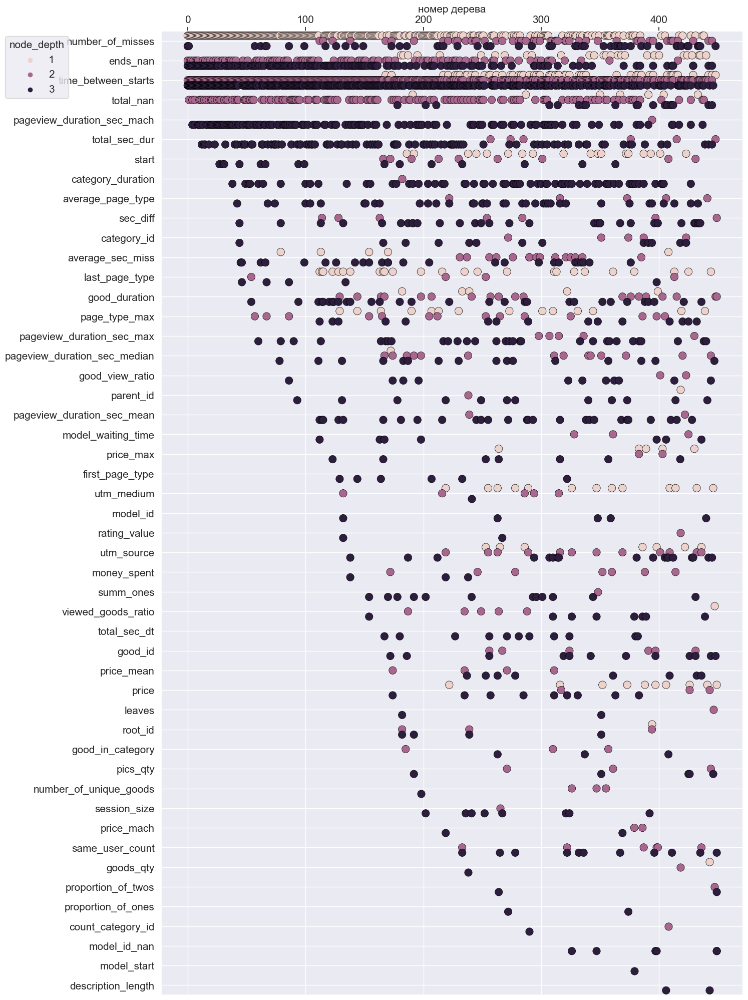

In [85]:
from importance_1.local_manipulations import *
params = {'eta': 0.1, 'objective': 'binary', 'num_boost_round':450, 'max_leaves': 30,'neg_bagging_fraction': 0.2, 'boosting': 'dart'}
t, model = train_model_get_t(X_tr_.drop(['sessionkey_id'], axis = 1), y_tr_, params)
plot_tree_info(t)

In [86]:
from sklearn.metrics import roc_auc_score
y_pred_val = model.predict(X_val_.drop(['sessionkey_id'], axis = 1))
roc_auc_score(y_true = y_val_, y_score= y_pred_val)

0.971108702125451

In [68]:
plot_feature_info(t)

In [87]:
import lightgbm as lgb
lgb_tr = lgb.Dataset(X_tr.drop([*features_to_drop, 'sessionkey_id'], axis = 1), X_tr.is_callcenter)
model = lgb.train(params, lgb_tr)
y_tst = model.predict(X_tst.drop([*features_to_drop[1:], 'sessionkey_id'], axis = 1))

/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/lightgbm/engine.py:172: UserWarning:

Found `num_boost_round` in params. Will use it instead of argument



[LightGBM] [Info] Number of positive: 37099, number of negative: 67496
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 8713
[LightGBM] [Info] Number of data points in the train set: 104595, number of used features: 54
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.354692 -> initscore=-0.598478
[LightGBM] [Info] Start training from score -0.598478


In [88]:
res = pd.DataFrame({'order_id': X_tst.order_id, 'is_callcenter': y_tst})


In [89]:
res.to_csv("fourth_sub.csv", index = False)

### Снижение разрмености(5 баллов)

Ну я ее юзаю практически везде

### Catboost(1 балл)

In [40]:
import catboost as cb

In [41]:
train_pool = cb.Pool(
    data= X_tr_.drop(['sessionkey_id'], axis = 1),
    label=y_tr_,
)

In [42]:
val_pool = cb.Pool(
    data = X_val_.drop(['sessionkey_id'], axis = 1),
    label = y_val_
)

In [43]:
cb_clf = cb.CatBoostClassifier(
    iterations=2000,
    learning_rate=0.1,
    depth=10,
    random_seed=0,
    eval_metric='AUC',
)

In [44]:
cb_clf.fit(
    train_pool,
    eval_set=val_pool,
    use_best_model=True,
    verbose=10,
    early_stopping_rounds=50,
)

0:	test: 0.9524984	best: 0.9524984 (0)	total: 202ms	remaining: 6m 44s
10:	test: 0.9662651	best: 0.9662651 (10)	total: 836ms	remaining: 2m 31s
20:	test: 0.9677760	best: 0.9677760 (20)	total: 1.5s	remaining: 2m 21s
30:	test: 0.9684776	best: 0.9684875 (29)	total: 2.13s	remaining: 2m 15s
40:	test: 0.9688832	best: 0.9688832 (40)	total: 2.69s	remaining: 2m 8s
50:	test: 0.9692666	best: 0.9692666 (50)	total: 3.25s	remaining: 2m 4s
60:	test: 0.9694129	best: 0.9694129 (60)	total: 3.76s	remaining: 1m 59s
70:	test: 0.9694874	best: 0.9695001 (69)	total: 4.23s	remaining: 1m 54s
80:	test: 0.9697063	best: 0.9697063 (80)	total: 4.71s	remaining: 1m 51s
90:	test: 0.9697178	best: 0.9697333 (81)	total: 5.18s	remaining: 1m 48s
100:	test: 0.9697760	best: 0.9697760 (100)	total: 5.67s	remaining: 1m 46s
110:	test: 0.9697731	best: 0.9697838 (104)	total: 6.13s	remaining: 1m 44s
120:	test: 0.9698460	best: 0.9698460 (120)	total: 6.6s	remaining: 1m 42s
130:	test: 0.9699297	best: 0.9699374 (128)	total: 7.08s	remainin

### Сделаем кластеризацию по значениям в листьях(парсинг датасета - 5 баллов)

В данном блоке я хотел получить три результата - понять нужно ли мне юзать dart, сделать кластеризацию и посмотреть на распределение ошибок

In [48]:
t.head()

,tree_index,node_depth,node_index,left_child,right_child,parent_index,split_feature,split_gain,threshold,decision_type,missing_direction,missing_type,value,weight,count
0,0,1,0-S0,0-S1,0-S3,None,number_of_misses,14114.799805,1.500000e+00,<=,left,NaN,-0.133583,0.000000,52297
1,0,2,0-S1,0-S10,0-S2,0-S0,ends_nan,9827.139648,1.000000e-35,<=,right,NaN,-0.113049,7030.260000,30665
2,0,3,0-S10,0-S14,0-S13,0-S1,time_between_starts,115.232002,4.946800e+02,<=,left,NaN,-0.163564,1529.850000,6673
3,0,4,0-S14,0-L0,0-L15,0-S10,time_between_starts,48.363899,2.118350e+01,<=,left,NaN,-0.166746,1209.580000,5276
4,0,5,0-L0,None,None,0-S14,None,NaN,NaN,None,None,None,-0.115833,9.399659,41


Посмотрим на профиль ансамбля для понимания в необходимости дарта

/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


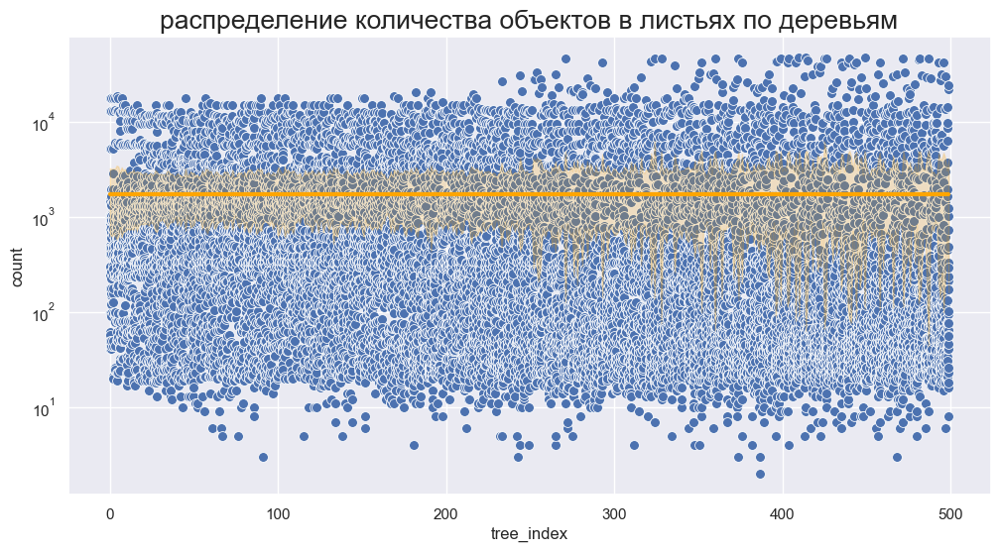

In [49]:
plt.title('распределение количества объектов в листьях по деревьям', fontsize=19)
sns.scatterplot(t.query('split_gain.isnull()'), x='tree_index', y='count', s=50)
sns.lineplot(t.query('split_gain.isnull()'), x='tree_index', y='count',  color='orange', lw=3)
plt.yscale('log')
plt.gcf().set_size_inches(12, 6)

/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


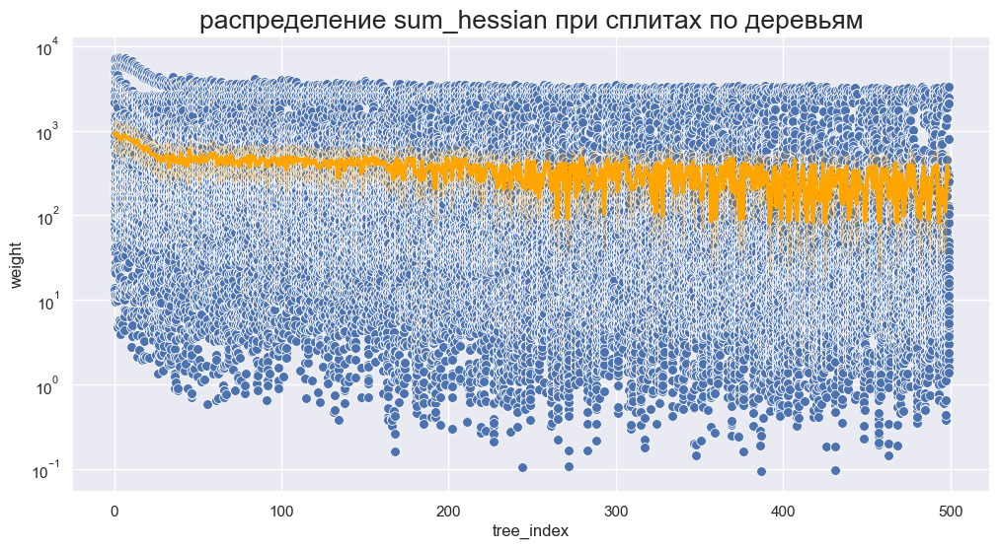

In [50]:
plt.title('распределение sum_hessian при сплитах по деревьям', fontsize=19)
sns.scatterplot(t, x='tree_index', y='weight', s=50)
sns.lineplot(t, x='tree_index', y='weight',  color='orange', lw=3)
plt.yscale('log')
plt.gcf().set_size_inches(12, 6)

/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


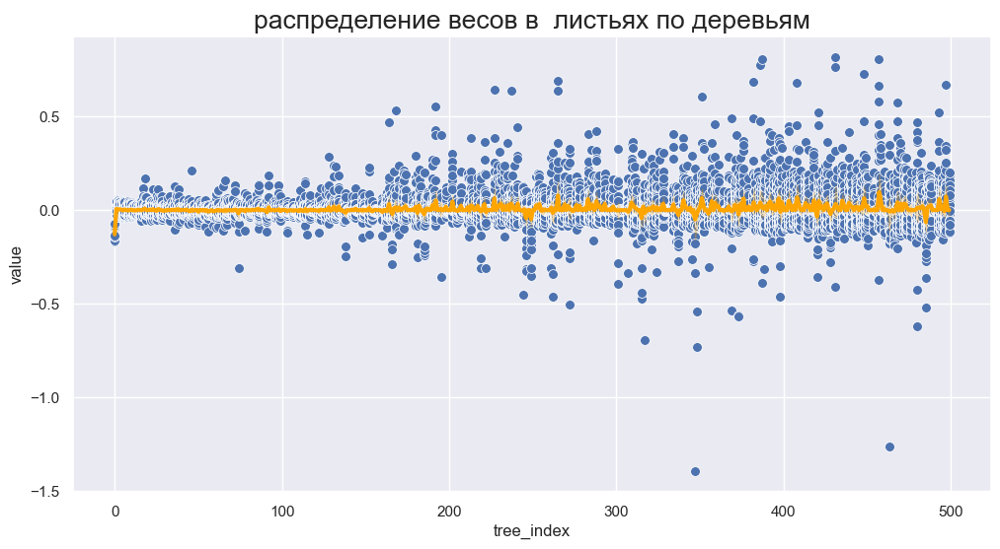

In [51]:
plt.title('распределение весов в  листьях по деревьям', fontsize=19)
sns.scatterplot(t.query('split_gain.isnull()'), x='tree_index', y='value', s=50)
sns.lineplot(t.query('split_gain.isnull()'), x='tree_index', y='value',  color='orange', lw=3)
plt.gcf().set_size_inches(12, 6)

/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


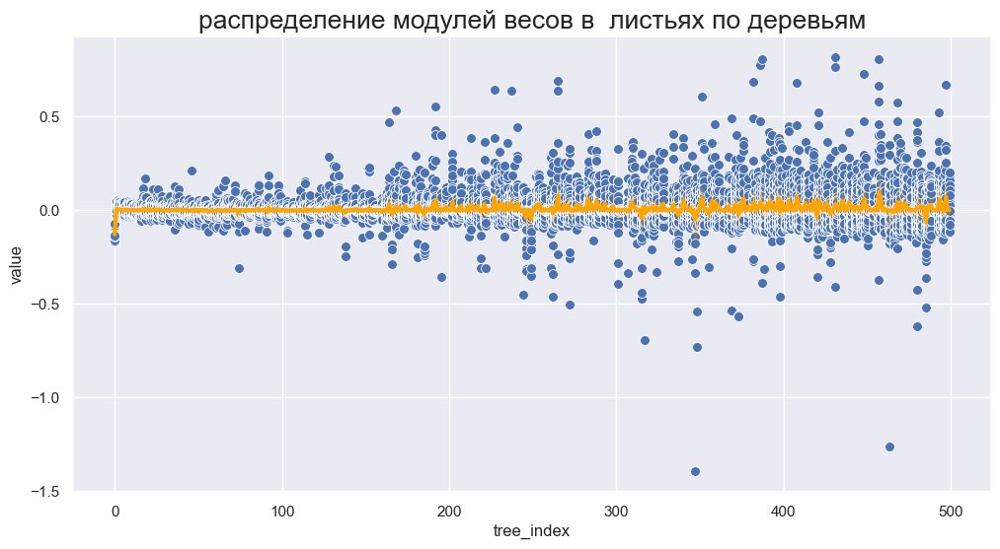

In [52]:
plt.title('распределение модулей весов в  листьях по деревьям', fontsize=19)
sns.scatterplot(t.query('split_gain.isnull()'), x='tree_index', y='value', s=50)
sns.lineplot(t.query('split_gain.isnull()'), x='tree_index', y='value',  color='orange', lw=3)
plt.gcf().set_size_inches(12, 6)

Исходя из графиков гессиана(вначале больше), а также количества обьектов в деревьях я выбрал дарт как типа бустинга

In [55]:
leaves = model.predict(X_tr_.drop(['sessionkey_id'], axis = 1), pred_leaf=True)
print('leaves:\n', leaves)

scores = np.array([
    [model.get_leaf_output(i, leaves[j, i]) for i in range(leaves.shape[1])] for j in range(leaves.shape[0])
])

print('\nscores:\n', scores)

leaves:
 [[ 2  2 16 ...  2  2 27]
 [ 8  8  8 ... 27 27 24]
 [ 8  8  8 ... 27  1 20]
 ...
 [28 14 14 ...  7 19 28]
 [ 2  2 16 ... 17 19 27]
 [29 17 15 ...  0  1  1]]

scores:
 [[-7.04565869e-02  4.69838414e-02  5.44468380e-02 ...  1.51004984e-03
  -3.91335269e-03  3.10642410e-02]
 [-1.64657783e-01 -2.84907811e-02 -3.59724510e-02 ... -7.47309141e-04
   1.17172100e-02 -1.70832561e-02]
 [-1.64657783e-01 -2.84907811e-02 -3.59724510e-02 ... -7.47309141e-04
  -8.23291190e-03 -1.02066875e-01]
 ...
 [-1.17905030e-01  1.28150231e-02  1.47940256e-02 ... -3.86537658e-07
   1.03696905e-02 -1.31722466e-03]
 [-7.04565869e-02  4.69838414e-02  5.44468380e-02 ...  8.15682804e-04
   1.03696905e-02  3.10642410e-02]
 [-1.64449282e-01 -2.82583201e-02 -3.57469001e-02 ... -8.93392922e-04
  -8.23291190e-03 -4.30587556e-02]]


Получились четкие кластеры, попробуем сделать такой признак.

In [56]:
import umap.umap_ as umap
import plotly.express as px

mapper = umap.UMAP(n_neighbors=30, n_jobs=8, metric='euclidean')
embedding = mapper.fit_transform(scores)

px.scatter(x=embedding[:, 0], y=embedding[:, 1], color=y_tr_)

2024-03-25 00:18:54.794309: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [57]:
y_pred = (model.predict(X_tr_.drop(['sessionkey_id'], axis = 1)) > 0.5).astype(int)

px.scatter(x=embedding[:, 0], y=embedding[:, 1], color= y_tr_ == y_pred)

In [58]:
px.scatter(x=embedding[:, 0], y=embedding[:, 1], color= X_tr_.money_spent)

Здесь я хотел посмотреть распределение ошибок на разных признаках, однако чего-то умного получить не удалось.(я посмотрел на многих фичах)

In [59]:
px.scatter(x=embedding[:, 0], y=embedding[:, 1], color= y_tr_)

Получили прикольные кластеры, которые после добавления в модель немного улучшили скор.

In [60]:
import hdbscan as hd
hdbscan_ = hd.HDBSCAN(min_samples=10, min_cluster_size=120, prediction_data = True)
tr_clusters_leaves = hdbscan_.fit_predict(embedding)
clusterers = hdbscan_.fit(embedding)

In [61]:
leaves = model.predict(X_val_.drop(['sessionkey_id'], axis = 1), pred_leaf=True)
scores_val = np.array([
    [model.get_leaf_output(i, leaves[j, i]) for i in range(leaves.shape[1])] for j in range(leaves.shape[0])
])
embedding_val = mapper.transform(scores_val)
val_clusters_leaves = hd.approximate_predict(clusterers, embedding_val)

In [62]:
leaves = model.predict(X_tst.drop([*features_to_drop[1:], 'sessionkey_id'], axis = 1), pred_leaf=True)
scores_tst = np.array([
    [model.get_leaf_output(i, leaves[j, i]) for i in range(leaves.shape[1])] for j in range(leaves.shape[0])
])
embedding_tst = mapper.transform(scores_tst)
tst_clusters_leaves = hd.approximate_predict(clusterers, embedding_tst)

### Попробуем более классическую кластеризацию (кластеризация + понижение размерности - 3 балла)

In [32]:
data.head()

,order_id,create_time,good_id,price,utm_medium,utm_source,sessionkey_id,category_id,parent_id,root_id,model_id,is_moderated,rating_value,rating_count,description_length,goods_qty,pics_qty,model_create_time,is_callcenter,model_waiting_time
87721,1158405,1975-11-01 09:00:05,60503617,584,5,13.0,112851257,1505,2844,1504,26989476,1,NaN,0.0,0,1,1,1975-07-31 03:06:45,0,8056400.0
13972,1158407,1975-11-01 09:09:56,55560055,662,1,2.0,112848617,1214,1213,1183,520544,1,5.0,2.0,169,12,2,1972-04-14 18:23:15,0,111941201.0
90161,1158408,1975-11-01 09:10:58,65031170,510,2,NaN,112851658,4455,4448,255,27815897,1,NaN,1.0,1921,2,1,1975-08-22 14:02:07,0,6116931.0
69290,1158409,1975-11-01 09:14:53,58615677,787,1,2.0,112848617,3548,2646,1183,16747208,1,NaN,0.0,382,5,1,1974-11-25 15:23:06,0,29440307.0
4188,1158410,1975-11-01 09:15:47,21297938,1433,1,2.0,112673919,2449,1212,1183,145731,1,4.0,12.0,926,24,16,1971-10-06 16:26:25,0,128450962.0


Для начала заметим, что у нас есть колонки айди, попробуем по ним сделать кластеризацию. Очевидно, что это кат признаки, поэтому воспользуемся расстоянием хемминга.

In [33]:
my_favorite_cols = ['category_id', 'root_id', 'parent_id', 'good_id', 'model_id']

plot_cols = np.r_[my_favorite_cols, ['is_callcenter']]
plot_data_tr = data[plot_cols].copy()

# СКЕЙЛИНГ
#means = plot_data_tr[my_favorite_cols].mean(axis=0)
#stds = plot_data_tr[my_favorite_cols].std(axis=0)

plot_data_tr.loc[:, my_favorite_cols] = (plot_data_tr.loc[:, my_favorite_cols])
plot_data_scaled = plot_data_tr

In [34]:
from reductors import *


2024-03-24 22:25:17.822172: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [36]:
from reductors import make_umap
from utils import plot_dim_reduction
from collections import namedtuple


hue_info = namedtuple('hue_info', ['field_name', 'is_categorical'])


def plot_standard_embeddings(plot_data, features, return_results=False):
    '''
    рисует "какие-то" эмбеддинги с hue='smoking' на одних и тех же фичах features
    '''
    mapper_dict = {
        'UMAP 2D n_neighbors=17': {
            'params': {
               'n_neighbors': 80,
               'min_dist': 0.01,
               'n_jobs': 8,
               'verbose': False,
               'n_components': 2,
               'metric': 'hamming'
            },
            'func': make_umap,
        },
    }

    res = plot_dim_reduction(
        data=plot_data,
        mapper_dict=mapper_dict,
        default_features=features,
        default_hue_info=hue_info(field_name='is_callcenter', is_categorical=True),
        row_height=450,
        return_results=return_results
    )
    return res


results = plot_standard_embeddings(plot_data_scaled, my_favorite_cols, return_results=True)

Loading BokehJS ...

  0%|          | 0/1 [00:00<?, ?it/s]/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/umap/umap_.py:1879: UserWarning: gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable
  warn(


100%|██████████| 1/1 [04:59<00:00, 299.88s/it]


Однако ничего хорошего получить не вышло, потому что получилось очень много островов(уникальных товаров многоо)

Построимм кластеры по всем доступным категориальным колонкам 

In [345]:
my_favorite_cols = ['price', 'description_length', 'pageview_duration_sec_mach', 'viewed_goods_ratio', 
                    'proportion_of_ones', 'sec_diff', 'time_between_starts', 'number_of_unique_goods', 'session_size',
                    'proportion_of_twos'
                    ]

plot_cols = np.r_[my_favorite_cols]
plot_data_tr = X_tr_[plot_cols].copy()

plot_data_tr['is_callcenter'] = y_tr_
# СКЕЙЛИНГ
plot_data_tr.fillna(-1, inplace = True)
means = plot_data_tr[my_favorite_cols].mean(axis=0)
stds = plot_data_tr[my_favorite_cols].std(axis=0)

plot_data_tr.loc[:, my_favorite_cols] = (plot_data_tr.loc[:, my_favorite_cols])
plot_data_scaled = plot_data_tr

In [356]:
from reductors import *
from utils import plot_dim_reduction
from collections import namedtuple


hue_info = namedtuple('hue_info', ['field_name', 'is_categorical'])


def plot_standard_embeddings(plot_data, features, return_results=False):
    '''
    рисует "какие-то" эмбеддинги с hue='smoking' на одних и тех же фичах features
    '''
    mapper_dict = {
        'tsne 2D perplexity=60 exaggeration=4 dof=0.5': {
            'params': {
                'n_jobs': 8,
                'perplexity': 60,
                'verbose': False,
                'n_components': 2,
                'exaggeration': 2,
                'dof': 0.5,
                'neighbors': 'pynndescent'
            },
            'func': make_tsne,
        },
        'UMAP 2D n_neighbors=17': {
            'params': {
               'n_neighbors': 13,
               'min_dist': 0.1,
               'n_jobs': 8,
               'verbose': False,
               'n_components': 2,
               'metric': 'euclidean'
            },
            'func': make_umap,
        },
    }

    res = plot_dim_reduction(
        data=plot_data,
        mapper_dict=mapper_dict,
        default_features=features,
        default_hue_info=hue_info(field_name='is_callcenter', is_categorical=True),
        row_height=450,
        return_results=return_results
    )
    return res


results = plot_standard_embeddings(plot_data_scaled, my_favorite_cols, return_results=True)

Loading BokehJS ...

  0%|          | 0/2 [00:00<?, ?it/s]

100%|██████████| 2/2 [05:04<00:00, 152.48s/it]


Получили интересные кластеры в tsne, посмотрим что получится на валидации

In [357]:
tsne_mapper_embedding = results['tsne 2D perplexity=60 exaggeration=4 dof=0.5']['embedding']

# Не делайте так, если у вас хватает памяти сделать копию!
val_data = X_val_[my_favorite_cols]

plot_data_val = X_val_[my_favorite_cols].copy()

# СКЕЙЛИНГ
plot_data_val.fillna(-1, inplace = True)
means = plot_data_val[my_favorite_cols].mean(axis=0)
stds = plot_data_val[my_favorite_cols].std(axis=0)

plot_data_val.loc[:, my_favorite_cols] = (plot_data_val.loc[:, my_favorite_cols])

tsne_val_embedding = tsne_mapper_embedding.transform(plot_data_val, perplexity=60)

In [432]:
tsne_mapper_embedding = results['tsne 2D perplexity=60 exaggeration=4 dof=0.5']['embedding']

# Не делайте так, если у вас хватает памяти сделать копию!
train_data = X_tr[my_favorite_cols]

plot_data_train = X_tr[my_favorite_cols].copy()

# СКЕЙЛИНГ
plot_data_train.fillna(-1, inplace = True)
means = plot_data_train[my_favorite_cols].mean(axis=0)
stds = plot_data_train[my_favorite_cols].std(axis=0)

plot_data_train.loc[:, my_favorite_cols] = (plot_data_train.loc[:, my_favorite_cols])

tsne_train_embedding = tsne_mapper_embedding.transform(plot_data_train, perplexity=60)

In [428]:
tsne_mapper_embedding = results['tsne 2D perplexity=60 exaggeration=4 dof=0.5']['embedding']

# Не делайте так, если у вас хватает памяти сделать копию!

plot_data_tst = X_tst[my_favorite_cols].copy()

# СКЕЙЛИНГ
plot_data_tst.fillna(-1, inplace = True)
means = plot_data_tst[my_favorite_cols].mean(axis=0)
stds = plot_data_tst[my_favorite_cols].std(axis=0)

plot_data_tst.loc[:, my_favorite_cols] = (plot_data_tst.loc[:, my_favorite_cols])

tsne_tst_embedding = tsne_mapper_embedding.transform(plot_data_tst, perplexity=60)

In [358]:
%%time
ç

CPU times: user 2.83 s, sys: 404 ms, total: 3.23 s
Wall time: 7.39 s


In [433]:
val_clusters, clusters = hd.approximate_predict(clusterer, tsne_val_embedding)
train_clusters, clusters = hd.approximate_predict(clusterer, tsne_train_embedding)

In [363]:
from sklearn.metrics import roc_auc_score
y_pred_val = model.predict(X_val_.drop(['sessionkey_id'], axis = 1))
roc_auc_score(y_true = y_val_, y_score= y_pred_val)

0.9705430861752484

Получили ухудшение в скоре модели, оно и понятно, данные содержат очень много нанов, причем в разном количестве, а также большинство хороших признаков - категориальные, поэтому кластеризация в принципе не очень возможна

### Сделаем SHAP (5 баллов)

In [38]:
import shap
shap.initjs()

In [45]:
explainer = shap.TreeExplainer(cb_clf)
shap_values = explainer(X_tr_.drop(['sessionkey_id'], axis = 1))

/Users/macbook/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:4527: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


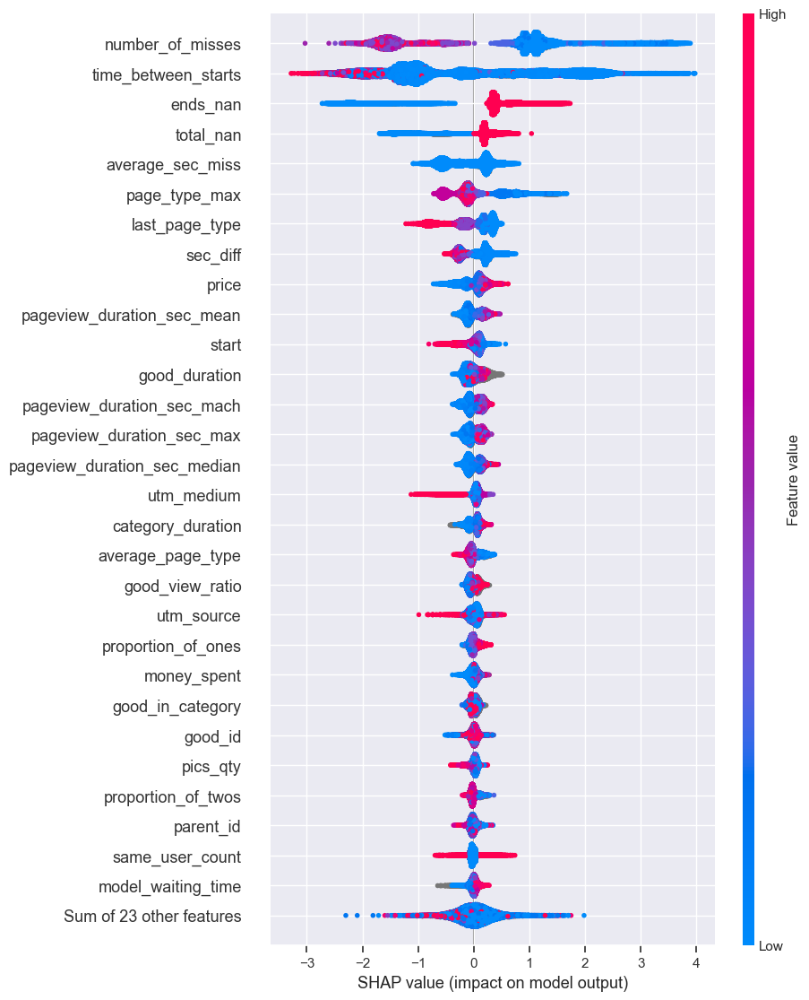

In [46]:
shap.plots.beeswarm(shap_values, max_display=30)

In [47]:
shap.plots.force(shap_values[:200])

Получили некоторые интересные интерпритируемые результаты:
1) При увелечении цены человек скорее позвонит
2) чем выше utm_medium, тем человек скорее не позвонит
3) чем меньше сессия, больше шанс звонка
4) чем меньше разброс цены, тем больше шанс звонка

1. В некоторых признаках(самых лучших) очевиден паттерн - чем меньше пропусков, тем скорее позвонит
2. Чем больше время между сессией и созданием модели - тем скорее не будет звонка
3. Чем больше время среднего пропуска, тем меньше вероятность звонка

Получили, что все признаки стали легко адекватными и интерпритируемыми(основная выгода от шапа - получить интерпретацию признаков)

Теперь попробуем построить кластеры по значениям в SHAP, что и является основной целью этого блока

In [108]:
%%time
import hdbscan as hd# немного долго импортируется в первый раз

hdbscan_ = hd.HDBSCAN(min_samples=10, min_cluster_size=120, prediction_data = True)
train_clusters_shap = hdbscan_.fit_predict(shap_values.values)


CPU times: user 1min 19s, sys: 898 ms, total: 1min 20s
Wall time: 1min 41s


In [101]:
clusterers = hdbscan_.fit(shap_values.values)

In [102]:
shap_values_val = explainer(X_val_.drop(['sessionkey_id'], axis = 1))

In [109]:
val_clusters_shap, _ = hd.approximate_predict(clusterers, shap_values_val.values)

In [104]:
shap_values_tst = explainer(X_tst.drop([*features_to_drop[1:], 'sessionkey_id'], axis = 1))

In [110]:
tst_clusters_shap, _ = hd.approximate_predict(clusterers, shap_values_tst.values)

Получили не очень хорошие кластеры, так как шап валью распределены по разному. 

### KNN (3 балла)

Целью данного блока было сделать KNN регрессию как признак для модели

In [35]:
X_tr_imp = X_tr_.copy()
X_val_imp = X_val_.copy()
X_tst_imp = X_tst.copy()

In [37]:
X_tr_imp.replace([-np.inf, np.inf], np.nan, inplace = True)
X_tr_imp.fillna(X_tr_imp.mean(), inplace=True)
X_val_imp.replace([-np.inf, np.inf], np.nan, inplace = True)
X_val_imp.fillna(X_tr_imp.mean(), inplace=True)
X_tst_imp.replace([-np.inf, np.inf], np.nan, inplace = True)
X_tst_imp.fillna(X_tr_imp.mean(), inplace=True)

In [47]:
from sklearn.neighbors import KNeighborsRegressor

knn_regressor = KNeighborsRegressor(n_neighbors=40)

knn_regressor.fit(X_tr_imp.drop(['sessionkey_id'], axis = 1), y_tr_)
predictions_val = knn_regressor.predict(X_val_imp.drop(['sessionkey_id'], axis = 1))
predictions_train = knn_regressor.predict(X_tr_imp.drop(['sessionkey_id'], axis = 1))
predictions_tst = knn_regressor.predict(X_tst_imp.drop([*features_to_drop[1:], 'sessionkey_id'], axis = 1))

Данный признак также получился не очень полезным, по тем же причинам, что и не работала кластеризация.